In [ ]:
import pandas as pd
import numpy as np

#'''Seaborn and Matplotlib Visualization'''
import matplotlib                  # 2D Plotting Library
import matplotlib.pyplot as plt
import seaborn as sns              # Python Data Visualization Library based on matplotlib
plt.style.use('fivethirtyeight')
%matplotlib inline

#'''Plotly Visualizations'''
import plotly as plotly                # Interactive Graphing Library for Python
import plotly.express as px
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode, iplot, plot
import plotly.offline as py
init_notebook_mode(connected=True)
import os
%pylab inline
import re

import warnings
warnings.filterwarnings('ignore')


In [2]:
data = pd.read_csv('CDC_CLEANED.csv')

In [3]:
data.dropna(inplace = True, thresh = 250000, axis = 1)

In [4]:
data.drop(['open-end_line_of_credit', 'rate_spread', 'total_loan_costs', 'origination_charges',
        'loan_term', 'interest_only_payment',
       'co-applicant_credit_score_type',
       'applicant_ethnicity-1', 'co-applicant_ethnicity-1', 'applicant_race-1',
       'co-applicant_race-1', 'co-applicant_age','applicant_age_above_62'], inplace = True, axis =1)

In [5]:
data.drop(['tract_owner_occupied_units', 'tract_one_to_four_family_homes','tract_median_age_of_housing_units','tract_population','total_units','business_or_commercial_purpose','preapproval','purchaser_type','action_taken','total_units','tract_population','census_tract']
          , axis =1, inplace = True)

In [6]:
data.head()

,county_code,conforming_loan_limit,derived_loan_product_type,derived_ethnicity,derived_race,derived_sex,loan_type,loan_purpose,loan_amount,loan_to_value_ratio,interest_rate,property_value,occupancy_type,income,debt_to_income_ratio,applicant_age,denial_reason-1,tract_minority_population_percent,ffiec_msa_md_median_family_income,tract_to_msa_income_percentage
0,37119.0,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,1,1,35000.0,NaN,6.5,55000,1,51.0,20%-<30%,55-64,10,68.84,70700,84
1,37119.0,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,1,1,35000.0,NaN,6.5,55000,1,51.0,20%-<30%,55-64,10,68.84,70700,84
2,37085.0,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Male,1,1,45000.0,NaN,NaN,NaN,1,36.0,20%-<30%,55-64,7,46.46,56500,73
3,37065.0,C,Conventional:First Lien,Not Hispanic or Latino,White,Male,1,1,15000.0,NaN,NaN,NaN,1,39.0,NaN,25-34,10,47.53,54700,79
4,37185.0,C,Conventional:First Lien,Not Hispanic or Latino,White,Joint,1,1,25000.0,NaN,9.95,NaN,1,92.0,38,45-54,10,69.46,51600,74


In [7]:
data.shape

(594769, 20)

In [8]:
data.dtypes

county_code                          float64
conforming_loan_limit                 object
derived_loan_product_type             object
derived_ethnicity                     object
derived_race                          object
derived_sex                           object
loan_type                              int64
loan_purpose                           int64
loan_amount                          float64
loan_to_value_ratio                   object
interest_rate                         object
property_value                        object
occupancy_type                         int64
income                               float64
debt_to_income_ratio                  object
applicant_age                         object
denial_reason-1                        int64
tract_minority_population_percent    float64
ffiec_msa_md_median_family_income      int64
tract_to_msa_income_percentage         int64
dtype: object

In [9]:
genderdata=data[(data["derived_sex"] != 'Sex Not Available')]
racedata = data[(data["derived_race"] != 'Race Not Available') & (data["derived_race"] != 'Free Form Text Only')]
ethnicdata = data[(data["derived_ethnicity"] != 'Ethnicity Not Available') & (data["derived_ethnicity"] != 'Free Form Text Only')]

(array([0, 1, 2, 3, 4, 5, 6]), <a list of 7 Text xticklabel objects>)

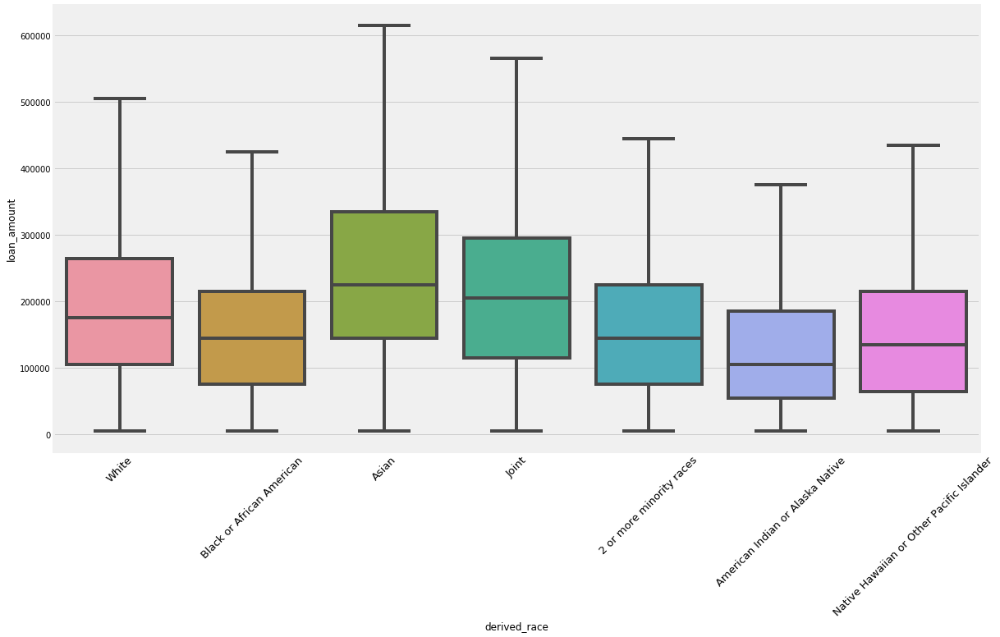

In [10]:
#SeaBorn BoxPlot: derived_race vs. loan_amount

plt.rcParams['figure.figsize'] = (18,10)
sns.boxplot(x = 'derived_race', y = 'loan_amount', data = racedata, showfliers = False)
plt.xticks(rotation = 45, size = 13)

(array([0, 1, 2]), <a list of 3 Text xticklabel objects>)

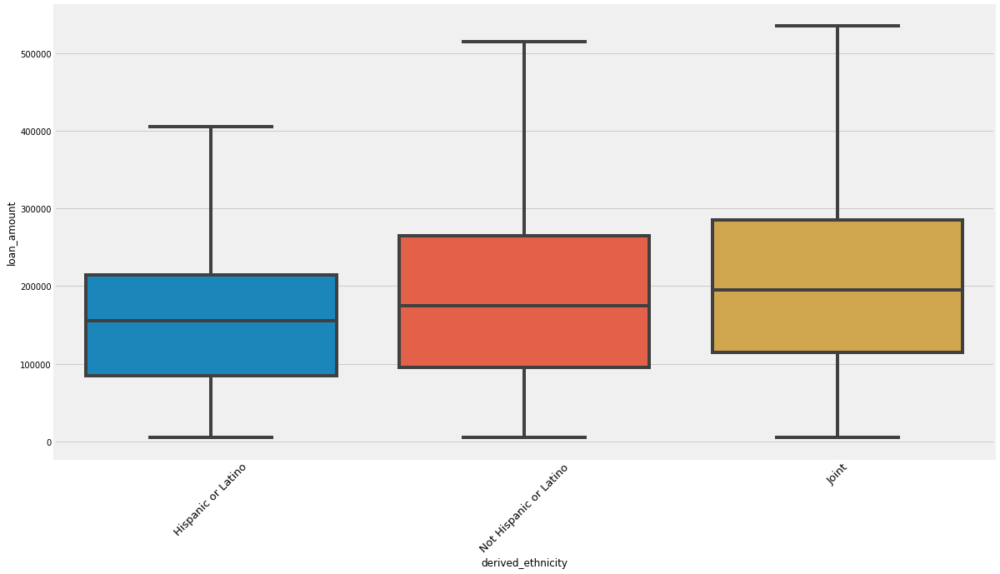

In [11]:
#SeaBorn BoxPlot: derived_ethnicity vs. loan_amount

loanvethdata=data[(data["derived_ethnicity"] != 'Sex Not Available')]
plt.rcParams['figure.figsize'] = (18,10)
sns.boxplot(x = 'derived_ethnicity', y = 'loan_amount', data = ethnicdata, showfliers = False)
plt.xticks(rotation = 45, size = 13)

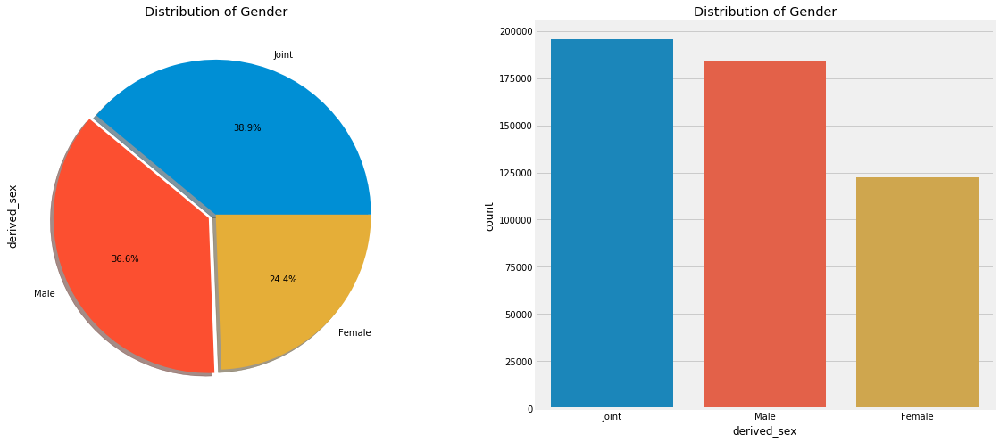

In [12]:
#Seaborn: Age Distribution

f,ax=plt.subplots(1,2,figsize=(18,8))

genderdata['derived_sex'].value_counts().plot.pie(explode=[0,0.05,0],autopct='%1.1f%%',ax=ax[0],shadow=True)
ax[0].set_title('Distribution of Gender')

sns.countplot('derived_sex',data=genderdata,ax=ax[1])
ax[1].set_title('Distribution of Gender')
plt.show()

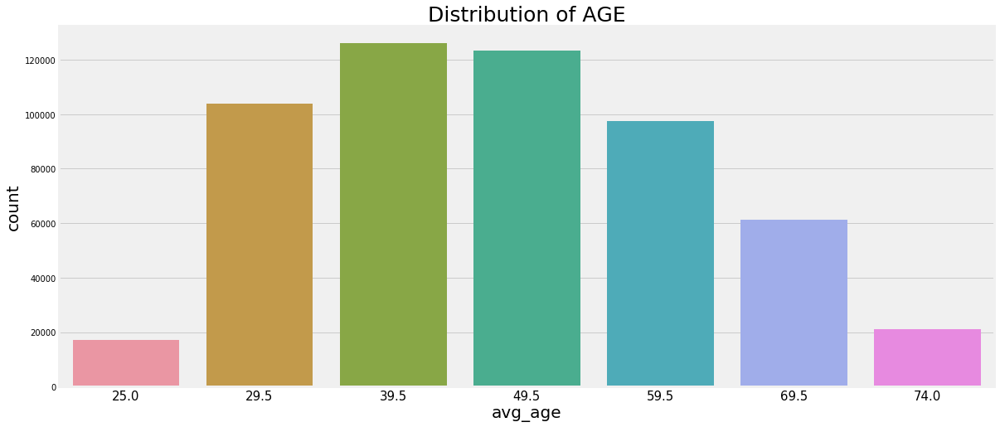

In [13]:
#Age distribution

data['min_age'] = data['applicant_age'].apply(lambda x: x.split('-')[0])
data['max_age'] = data['applicant_age'].apply(lambda x: x.split('-')[-1])
data['min_age'] = data['min_age'].apply(lambda x: x.replace('>','').replace('<',''))
data['max_age'] = data['max_age'].apply(lambda x: x.replace('>','').replace('<',''))
data['max_age'] = pd.to_numeric(data['max_age'])
data['min_age'] = pd.to_numeric(data['min_age'])
data['avg_age'] = (data['max_age'] + data['min_age'])/2

#filter out 8888.0 and 9999.0 years old rows
data = data[(data['avg_age']!=8888.0) & (data['avg_age']!= 9999.0)]

plt.rcParams['figure.figsize'] = (18,8)
plt.xticks(size = 15)
plt.xlabel('AGE',size = 20)
plt.ylabel('COUNT', size = 20)
plt.title('Distribution of AGE', size = 25)
sns.countplot(data['avg_age'])

In [14]:
#Plotly Derived Race Distributions

labels = sorted(racedata.derived_race.unique())
values = racedata.derived_race.value_counts().sort_index()
colors = ['DarkGrey', 'HotPink']



fig = go.Figure(data=[go.Pie(labels=labels,
                             values=values, pull=[0, 0.06])])
fig.update_traces(hoverinfo='label+value', textinfo='percent',textfont_size=20,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))

fig.update_layout(title_text="Distribution of Derived Race")
fig.show()

In [15]:
#Plotly: Derived Ethnicity Distribution

labels = sorted(ethnicdata.derived_ethnicity.unique())
values = ethnicdata.derived_ethnicity.value_counts().sort_index()
colors = ['DarkGrey', 'HotPink']


fig = go.Figure(data=[go.Pie(labels=labels,
                             values=values, pull=[0, 0.06])])
fig.update_traces(hoverinfo='label+value', textinfo='percent',textfont_size=20,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))

fig.update_layout(title_text="Distribution of Derived Ethnicity")
fig.show()

In [18]:
#Plotly: Conforming Loan Limit - Gender

ccl_c = genderdata[genderdata['conforming_loan_limit'] == 'C']
ccl_nc = genderdata[genderdata['conforming_loan_limit'] == 'NC']
ccl_u = genderdata[genderdata['conforming_loan_limit'] == 'U']

trace1 = go.Histogram(
    x=ccl_c.derived_sex,
    opacity=0.85,
    name = "Conforming",
    marker=dict(color='LightSeaGreen',line=dict(color='#000000', width=2)))
trace2 = go.Histogram(
    x=ccl_nc.derived_sex,
    opacity=0.85,
    name = "Not Conforming",
    marker=dict(color='Crimson',line=dict(color='#000000', width=2)))
trace3 = go.Histogram(
    x=ccl_u.derived_sex,
    opacity=0.85,
    name = "Undeterminate",
    marker=dict(color='Coral',line=dict(color='#000000', width=2)))

plotdata = [trace1, trace2, trace3]
layout = go.Layout(barmode='stack',
                   title='Conforming Loan Limit - GENDER',
                   xaxis=dict(title='GENDER'),
                   yaxis=dict( title='COUNT'),
                   template = 'plotly_dark'
)
fig = go.Figure(data=plotdata, layout=layout)
iplot(fig)

In [19]:
#Plotly: Conforming Loan Limit - Derived Race

ccl_c = racedata[racedata['conforming_loan_limit'] == 'C']
ccl_nc = racedata[racedata['conforming_loan_limit'] == 'NC']
ccl_u = racedata[racedata['conforming_loan_limit'] == 'U']

trace1 = go.Histogram(
    x=ccl_c.derived_race,
    opacity=0.85,
    name = "Conforming",
    marker=dict(color='DodgerBlue',line=dict(color='#000000', width=2)))
trace2 = go.Histogram(
    x=ccl_nc.derived_race,
    opacity=0.85,
    name = "Not Conforming",
    marker=dict(color='Crimson',line=dict(color='#000000', width=2)))
trace3 = go.Histogram(
    x=ccl_u.derived_race,
    opacity=0.85,
    name = "Undeterminate",
    marker=dict(color='Coral',line=dict(color='#000000', width=2)))



plotdata = [trace1, trace2, trace3]
layout = go.Layout(barmode='stack',
                   title='Conforming Loan Limit - RACE',
                   xaxis=dict(title='RACE'),
                   yaxis=dict( title='COUNT'),
                   template = 'plotly_dark'
)
fig = go.Figure(data=plotdata, layout=layout)
iplot(fig)

In [ ]:
new_data = data[pd.notnull(data['county_code'])]
fin_data = new_data.copy()

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder, StandardScaler, OrdinalEncoder
from sklearn.pipeline import Pipeline
from sklearn.compose import make_column_selector as selector

numeric_features = ['income', 'loan_amount', 'tract_minority_population_percent']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])

categorical_features = ['applicant_age', 'derived_sex', 'derived_race', 'derived_ethnicity', 'loan_type', 'county_code', 'denial_reason-1']

categorical_transformer = Pipeline(steps=[
    ('encoder', OrdinalEncoder()),
    #('imputer', SimpleImputer(strategy='constant', fill_value='mode')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
     ])

preprocessor = ColumnTransformer(transformers=[
    ('num', numeric_transformer, selector(dtype_exclude='object')),
    ('cat', categorical_transformer, selector(dtype_include='object'))
    ])

total_features = ['income', 'loan_amount', 'tract_minority_population_percent', 'applicant_age', 'derived_sex', 'derived_race', 'derived_ethnicity', 'loan_type', 'county_code', 'denial_reason-1']

In [ ]:
preprocessor.fit_transform(fin_data[total_features])